# *Hi, THE FOLLOWING STEPS ARE DONE TO EXPLORE DATA AND CREATE TRAIN AND TEST DATA*

In [10]:
from tqdm import tqdm
from nltk.translate.bleu_score import sentence_bleu,corpus_bleu
import numpy as np
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.image as mpimg


In [11]:
from torch.utils.tensorboard import SummaryWriter
writer = SummaryWriter('/content/resnet_lstm')

**Hi, don't forget to first upload the data on your own drive, and make sure there are no restrictions involved through drive.**

In [12]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [13]:
!unzip /content/drive/MyDrive/Filckr8k.zip

Streaming output truncated to the last 5000 lines.
  inflating: Filckr8k/Images/2844846111_8c1cbfc75d.jpg  
  inflating: __MACOSX/Filckr8k/Images/._2844846111_8c1cbfc75d.jpg  
  inflating: Filckr8k/Images/1082252566_8c79beef93.jpg  
  inflating: __MACOSX/Filckr8k/Images/._1082252566_8c79beef93.jpg  
  inflating: Filckr8k/Images/1386251841_5f384a0fea.jpg  
  inflating: __MACOSX/Filckr8k/Images/._1386251841_5f384a0fea.jpg  
  inflating: Filckr8k/Images/2196316998_3b2d63f01f.jpg  
  inflating: __MACOSX/Filckr8k/Images/._2196316998_3b2d63f01f.jpg  
  inflating: Filckr8k/Images/3106791484_13e18c33d8.jpg  
  inflating: __MACOSX/Filckr8k/Images/._3106791484_13e18c33d8.jpg  
  inflating: Filckr8k/Images/3603064161_a8f3b6455d.jpg  
  inflating: __MACOSX/Filckr8k/Images/._3603064161_a8f3b6455d.jpg  
  inflating: Filckr8k/Images/2293149170_38fb2257ea.jpg  
  inflating: __MACOSX/Filckr8k/Images/._2293149170_38fb2257ea.jpg  
  inflating: Filckr8k/Images/2451114871_8617ae2f16.jpg  
  inflating: __MA

In [14]:
image_data_location = "/content/Filckr8k/Images"
caption_data_location = "/content/Filckr8k/captions_images.txt"

In [15]:
df = pd.read_csv(caption_data_location)

In [16]:
df.head()

,image,caption
0,1000268201_693b08cb0e.jpg,A child in a pink dress is climbing up a set o...
1,1000268201_693b08cb0e.jpg,A girl going into a wooden building .
2,1000268201_693b08cb0e.jpg,A little girl climbing into a wooden playhouse .
3,1000268201_693b08cb0e.jpg,A little girl climbing the stairs to her playh...
4,1000268201_693b08cb0e.jpg,A little girl in a pink dress going into a woo...


In [17]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40455 entries, 0 to 40454
Data columns (total 2 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   image    40455 non-null  object
 1   caption  40455 non-null  object
dtypes: object(2)
memory usage: 632.2+ KB


In [18]:
train_data_df = df.iloc[:40000,:]
test_data_df = df.iloc[40000:,:]

In [19]:
train_data_df.tail()

,image,caption
39995,887108308_2da97f15ef.jpg,A child walks while holding an adult 's hand .
39996,887108308_2da97f15ef.jpg,A man holds a child 's hand as they walk .
39997,887108308_2da97f15ef.jpg,A woman walks hand-in-hand with a little boy w...
39998,887108308_2da97f15ef.jpg,A young boy has his hand in the back of his pa...
39999,887108308_2da97f15ef.jpg,The man is walking with a young child outside .


In [20]:
test_data_df.head()

,image,caption
40000,888425986_e4b6c12324.jpg,A boy is upside down in midair near a lake at ...
40001,888425986_e4b6c12324.jpg,A person does a flip by two sailboats and a la...
40002,888425986_e4b6c12324.jpg,A person flipping upside down
40003,888425986_e4b6c12324.jpg,a person in midair doing a back flip .
40004,888425986_e4b6c12324.jpg,A person is doing a flip in midair near a lake...


In [21]:
train_data_df.to_csv('train_captions.txt',index = False)
test_data_df.to_csv('test_captions.txt', index = False)

In [22]:
train_data_location = '/content/train_captions.txt'
test_data_location = '/content/test_captions.txt'

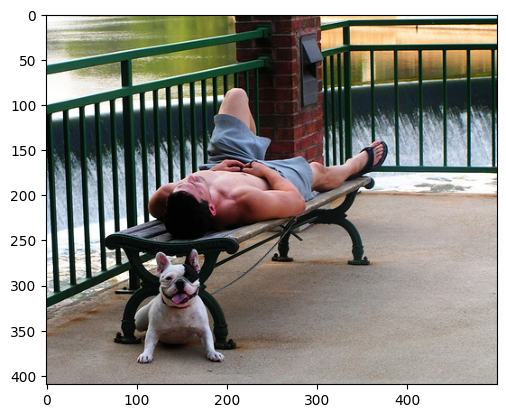

Caption - A man lays on the bench to which a white dog is also tied .
Caption - a man sleeping on a bench outside with a white and black dog sitting next to him .
Caption - A shirtless man lies on a park bench with his dog .
Caption - man laying on bench holding leash of dog sitting on ground
Caption - A man in an orange hat starring at something .


In [23]:
data_idx = 16
image_path = image_data_location + "/" + df.iloc[data_idx,0]
# print( df.iloc[data_idx,:])
img = mpimg.imread(image_path)
plt.imshow(img)
plt.show()

for i in range(data_idx, data_idx+5):
    print(f"Caption - {df.iloc[i,1]}")

In [25]:
import os
from collections import Counter
import spacy
import torch
from torch.nn.utils.rnn import pad_sequence
from torch.utils.data import DataLoader, Dataset
import torchvision.transforms as T

In [48]:
import torch
import numpy as np
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

import torchvision.models as models
from torch.utils.data import DataLoader,Dataset
import torchvision.transforms as T

In [26]:
spacy_eng = spacy.load('en_core_web_sm')
text = "This is a good place to find a city"
[token.text.lower() for token in spacy_eng.tokenizer(text)]

['this', 'is', 'a', 'good', 'place', 'to', 'find', 'a', 'city']

# Creating the vacabulary class 

This class creates the actual mapping of the words to its integer and vice-versa. This helps in assiging a numerical value to a word, that can be easily processed by the model.

This class also keeps track of the different words in the "vocabulary" of the model.

In [27]:
class Vocabulary:
    def __init__(self,freq_threshold):
        self.itos = {0:"<PAD>",1:"<SOS>",2:"<EOS>",3:"<UNK>"}
        self.stoi = {v:k for k,v in self.itos.items()}
        self.freq_threshold = freq_threshold
    
    def __len__(self):
        return len(self.itos)
    
    @staticmethod
    def tokenize(text):
        return [token.text.lower() for token in spacy_eng.tokenizer(text)]
    
    def build_vocab(self,sentence_list):
        frequencies = Counter()
        idx = 4
        for sentence in sentence_list:
            for word in self.tokenize(sentence):
                frequencies[word] += 1
                
                if frequencies[word] == self.freq_threshold:
                    self.stoi[word] = idx
                    self.itos[idx] = word
                    idx += 1
    
    def numericalize(self,text):
        tokenized_text = self.tokenize(text)
        return [self.stoi[token] if token in self.stoi else self.stoi["<UNK>"] for token in tokenized_text]
                
                

In [28]:
v = Vocabulary(freq_threshold=1)
v.build_vocab(["This is a new city"])
print(v.stoi)
print(v.numericalize("This is a new city"))

{'<PAD>': 0, '<SOS>': 1, '<EOS>': 2, '<UNK>': 3, 'this': 4, 'is': 5, 'a': 6, 'new': 7, 'city': 8}
[4, 5, 6, 7, 8]


In [29]:
df = pd.read_csv(caption_data_location)
print(df["image"][0][::-1])

gpj.e0bc80b396_1028620001


In [30]:
class CustomDataset(Dataset):
    def __init__(self,root_dir,captions_file,transform=None, freq_threshold=5):
        self.root_dir = root_dir
        self.df = pd.read_csv(captions_file)
        
        self.transform = transform
        self.imgs = self.df["image"]
        self.captions = self.df["caption"]
        
        self.vocab = Vocabulary(freq_threshold)
        self.vocab.build_vocab(self.captions.tolist())
    
    def __len__(self):
        return len(self.df)
    
    def __getitem__(self,idx):
        caption = self.captions[idx]
        img_name = self.imgs[idx]
        
        img_location = os.path.join(self.root_dir,img_name)
        img = Image.open(img_location).convert("RGB")
        
        if self.transform is not None:
            img = self.transform(img)
            
        caption_vec = []
        caption_vec += [self.vocab.stoi["<SOS>"]]
        caption_vec += self.vocab.numericalize(caption)
        caption_vec += [self.vocab.stoi["<EOS>"]]
        
        return img, torch.tensor(caption_vec)

In [31]:
#defing the transform to be applied
transforms = T.Compose([
    T.Resize((224,224)),
    T.ToTensor()
])

In [32]:
def show_image(inp, title=None):
    """Imshow for Tensor"""
    inp = inp.numpy().transpose((1,2,0))
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)

In [33]:
# testing the dataset
dataset = CustomDataset(
        root_dir = image_data_location,
        captions_file = train_data_location,
        transform = transforms
)

In [35]:
print(len(dataset))

40000


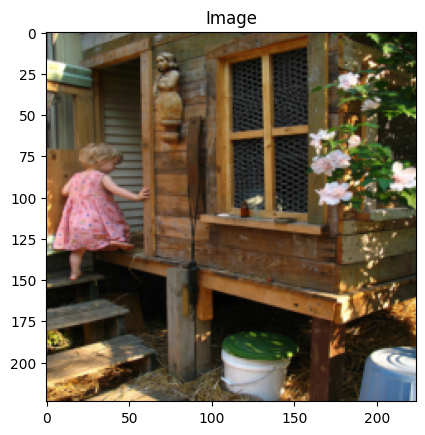

Token : tensor([  1,   4,   7, 316,  76,   4, 157,  74,   5,   2])
Sentence: 
['<SOS>', 'a', 'girl', 'going', 'into', 'a', 'wooden', 'building', '.', '<EOS>']


In [34]:
img, caps = dataset[1]
# print(caps)
show_image(img,"Image")
print("Token :",caps)
print("Sentence: ")
print([dataset.vocab.itos[token] for token in caps.tolist()])

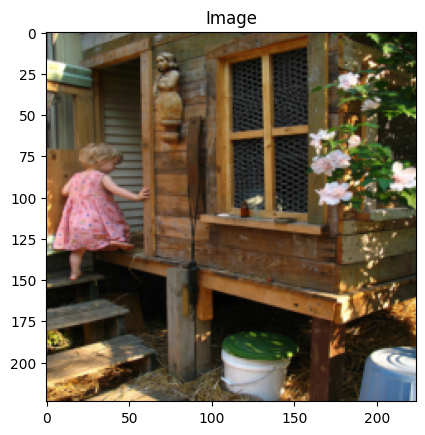

Token : tensor([  1,   4,  28,   8,   4, 195, 151,  17,  32,  67,   4, 353,  11, 711,
          8,  24,   3, 496,   5,   2])
Sentence: 
['<SOS>', 'a', 'child', 'in', 'a', 'pink', 'dress', 'is', 'climbing', 'up', 'a', 'set', 'of', 'stairs', 'in', 'an', '<UNK>', 'way', '.', '<EOS>']


In [36]:
img, caps = dataset[0]
show_image(img,"Image")
print("Token :",caps)
print("Sentence: ")
print([dataset.vocab.itos[token] for token in caps.tolist()])

In [37]:
class CapsCollate:
    def __init__(self,pad_idx,batch_first=False):
        self.pad_idx = pad_idx
        self.batch_first = batch_first
        
    def __call__(self,batch):
        imgs = [item[0].unsqueeze(0) for item in batch]
#         print(f"shape - {(imgs)}")
#         print("----"*22)
        imgs = torch.cat(imgs,dim=0)
#         print(f"shape - {imgs}")
#         print("------")
        targets = [item[1] for item in batch]
        targets = pad_sequence(targets, batch_first=self.batch_first, padding_value=self.pad_idx)
        return imgs,targets

In [38]:
#writing the dataloader
#setting the constants
BATCH_SIZE = 4
NUM_WORKER = 1

#token to represent the padding
pad_idx = dataset.vocab.stoi["<PAD>"]

data_loader = DataLoader(
    dataset=dataset,
    batch_size=BATCH_SIZE,
    num_workers=NUM_WORKER,
    shuffle=True,
    collate_fn=CapsCollate(pad_idx=pad_idx,batch_first=True)
)

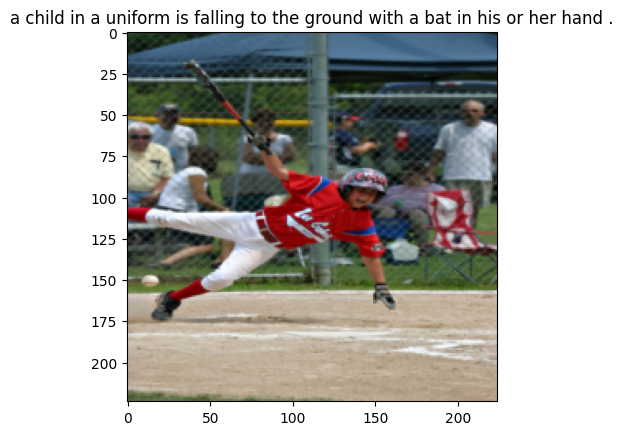

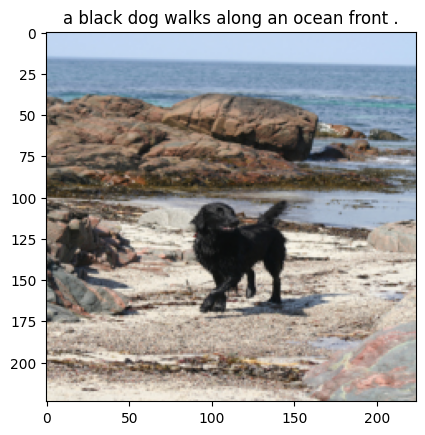

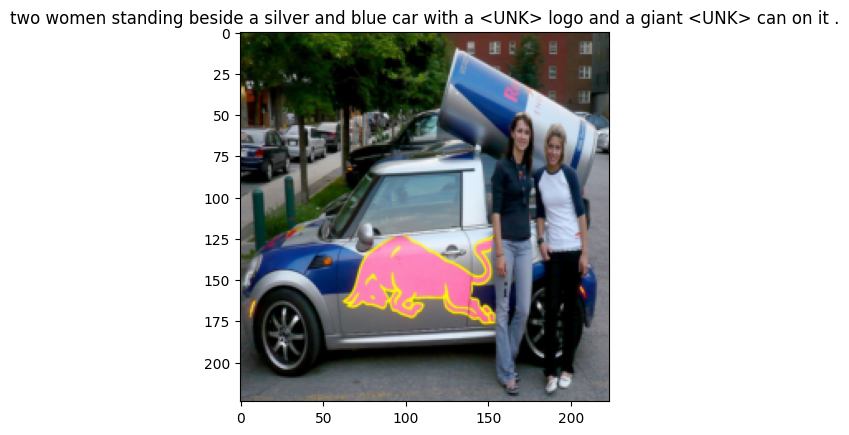

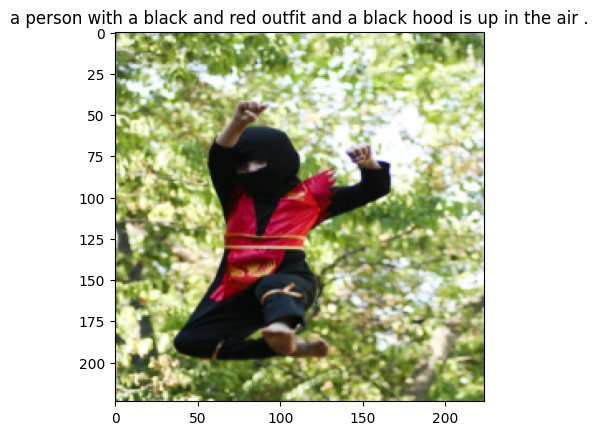

In [39]:
#generating the iterator from the dataloader
dataiter = iter(data_loader)

#getting the next batch
batch = next(dataiter)

#unpacking the batch
images, captions = batch

#showing info of image in single batch
for i in range(BATCH_SIZE):
    img,cap = images[i],captions[i]
#     print(f"captions - {captions[i]}")
    caption_label = [dataset.vocab.itos[token] for token in cap.tolist()]
    eos_index = caption_label.index('<EOS>')
    caption_label = caption_label[1:eos_index]
    caption_label = ' '.join(caption_label)                      
    show_image(img,caption_label)
    plt.show()

In [40]:
import torch
import torch.nn as nn
import torchvision.models as models
import torch.optim as optim

In [ ]:
# vgg16 = models.resnet50(pretrained=True)
# for param in vgg16.parameters():
#     param.requires_grad_(False)
# modules = list(vgg16.children())[:-1]
# print(dir(vgg16))

# ENCODERCNN class 

This class is where the feature extraction model is there. We utilized two feature extractors: **VGG16 **and **resnet50**. There are several others that can also be used. Care must be taken to ensure the output and the input given to the instance of this class as that may cause the feature extractor to either work properly or raise errors. 

Here we are using the resnet50 pretrained model.

# DECODER-RNN class

This class takes in feature extracted by the feature extractor and the captions and returns the outputs. It includes a generate captions function that return the predictd caption of the model.

Here we are using LSTM layer.

In [41]:
class EncoderCNN(nn.Module):
    def __init__(self):
        super(EncoderCNN, self).__init__()
        resnet = models.resnet50(pretrained=True)
        for param in resnet.parameters():
            param.requires_grad_(False)
        
        modules = list(resnet.children())[:-2]
        self.resnet = nn.Sequential(*modules)
        

    def forward(self, images):
        features = self.resnet(images)                                    #(batch_size,2048,7,7)
        features = features.permute(0, 2, 3, 1)                           #(batch_size,7,7,2048)
        features = features.view(features.size(0), -1, features.size(-1)) #(batch_size,49,2048)
        return features


#Bahdanau Attention
class Attention(nn.Module):
    def __init__(self, encoder_dim,decoder_dim,attention_dim):
        super(Attention, self).__init__()
        
        self.attention_dim = attention_dim
        
        self.W = nn.Linear(decoder_dim,attention_dim)
        self.U = nn.Linear(encoder_dim,attention_dim)
        
        self.A = nn.Linear(attention_dim,1)
        
        
        
        
    def forward(self, features, hidden_state):
        u_hs = self.U(features)     #(batch_size,num_layers,attention_dim)
        w_ah = self.W(hidden_state) #(batch_size,attention_dim)
        
        combined_states = torch.tanh(u_hs + w_ah.unsqueeze(1)) #(batch_size,num_layers,attemtion_dim)
        
        attention_scores = self.A(combined_states)         #(batch_size,num_layers,1)
        attention_scores = attention_scores.squeeze(2)     #(batch_size,num_layers)
        
        
        alpha = F.softmax(attention_scores,dim=1)          #(batch_size,num_layers)
        
        attention_weights = features * alpha.unsqueeze(2)  #(batch_size,num_layers,features_dim)
        attention_weights = attention_weights.sum(dim=1)   #(batch_size,num_layers)
        
        return alpha,attention_weights

#Attention Decoder
class DecoderRNN(nn.Module):
    def __init__(self,embed_size, vocab_size, attention_dim,encoder_dim,decoder_dim,drop_prob=0.3):
        super().__init__()
        
        #save the model param
        self.vocab_size = vocab_size
        self.attention_dim = attention_dim
        self.decoder_dim = decoder_dim
        
        self.embedding = nn.Embedding(vocab_size,embed_size)
        self.attention = Attention(encoder_dim,decoder_dim,attention_dim)
        
        
        self.init_h = nn.Linear(encoder_dim, decoder_dim)  
        self.init_c = nn.Linear(encoder_dim, decoder_dim)  
        self.lstm_cell = nn.LSTMCell(embed_size+encoder_dim,decoder_dim,bias=True)
        self.f_beta = nn.Linear(decoder_dim, encoder_dim)
        
        
        self.fcn = nn.Linear(decoder_dim,vocab_size)
        self.drop = nn.Dropout(drop_prob)
        
        
    
    def forward(self, features, captions):
        
        #vectorize the caption
        embeds = self.embedding(captions)
        
        # Initialize LSTM state
        h, c = self.init_hidden_state(features)  # (batch_size, decoder_dim)
        
        #get the seq length to iterate
        seq_length = len(captions[0])-1 #Exclude the last one
        batch_size = captions.size(0)
        num_features = features.size(1)
        
        preds = torch.zeros(batch_size, seq_length, self.vocab_size).to(device)
        alphas = torch.zeros(batch_size, seq_length,num_features).to(device)
                
        for s in range(seq_length):
            alpha,context = self.attention(features, h)
            lstm_input = torch.cat((embeds[:, s], context), dim=1)
            h, c = self.lstm_cell(lstm_input, (h, c))
                    
            output = self.fcn(self.drop(h))
            
            preds[:,s] = output
            alphas[:,s] = alpha  
        
        
        return preds, alphas
    
    def generate_caption(self,features,max_len=20,vocab=None):
        # Inference part
        # Given the image features generate the captions
        
        batch_size = features.size(0)
        h, c = self.init_hidden_state(features)  # (batch_size, decoder_dim)
        
        alphas = []
        
        #starting input
        word = torch.tensor(vocab.stoi['<SOS>']).view(1,-1).to(device)
        embeds = self.embedding(word)

        
        captions = []
        
        for i in range(max_len):
            alpha,context = self.attention(features, h)
            
            
            #store the apla score
            alphas.append(alpha.cpu().detach().numpy())
            
            lstm_input = torch.cat((embeds[:, 0], context), dim=1)
            h, c = self.lstm_cell(lstm_input, (h, c))
            output = self.fcn(self.drop(h))
            output = output.view(batch_size,-1)
        
            
            #select the word with most val
            predicted_word_idx = output.argmax(dim=1)
            
            #save the generated word
            captions.append(predicted_word_idx.item())
            
            #end if <EOS detected>
            if vocab.itos[predicted_word_idx.item()] == "<EOS>":
                break
            
            #send generated word as the next caption
            embeds = self.embedding(predicted_word_idx.unsqueeze(0))
        
        #covert the vocab idx to words and return sentence
        return [vocab.itos[idx] for idx in captions],alphas
    
    
    def init_hidden_state(self, encoder_out):
        mean_encoder_out = encoder_out.mean(dim=1)
        h = self.init_h(mean_encoder_out)  # (batch_size, decoder_dim)
        c = self.init_c(mean_encoder_out)
        return h, c

In [42]:
class EncoderDecoder(nn.Module):
    def __init__(self,embed_size, vocab_size, attention_dim,encoder_dim,decoder_dim,drop_prob=0.3):
        super().__init__()
        self.encoder = EncoderCNN()
        self.decoder = DecoderRNN(
            embed_size=embed_size,
            vocab_size = len(dataset.vocab),
            attention_dim=attention_dim,
            encoder_dim=encoder_dim,
            decoder_dim=decoder_dim
        )
        
    def forward(self, images, captions):
        features = self.encoder(images)
        outputs = self.decoder(features, captions)
        return outputs

In [43]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

In [44]:
# Hyperparameters
embed_size=400
vocab_size = len(dataset.vocab)
attention_dim=256
encoder_dim=2048
decoder_dim=512
learning_rate = 3e-4

In [46]:
# initialize model, loss etc
#init model
model = EncoderDecoder(embed_size=400,vocab_size = len(dataset.vocab),attention_dim=256,encoder_dim=2048,decoder_dim=512).to(device)

criterion = nn.CrossEntropyLoss(ignore_index=dataset.vocab.stoi["<PAD>"])
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 138MB/s]


Set the num_epochs to 20.

Technically, image caption models are trained for many more epochs, however due to resource(compute units) constraints of the Google Colab, we are limiting the model training to only this many epochs.

For 20 epochs the model took about ~3 hrs.

# Model Training

Epoch: 1 loss: 3.16925


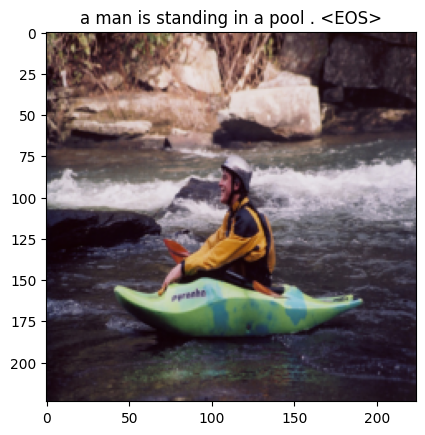

Epoch: 1 loss: 3.17169


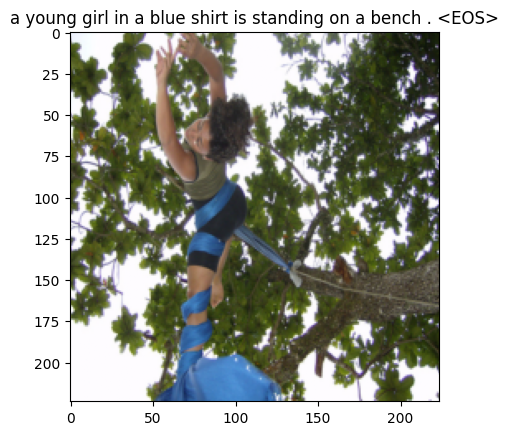

Epoch: 2 loss: 3.89844


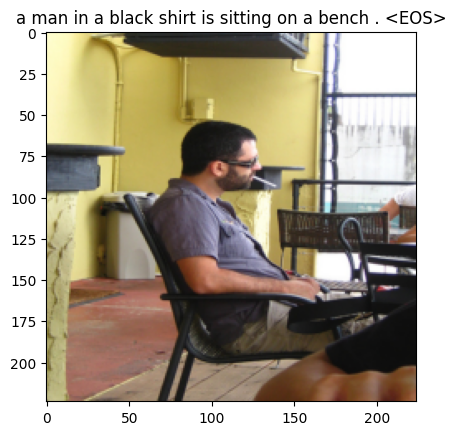

Epoch: 2 loss: 2.39586


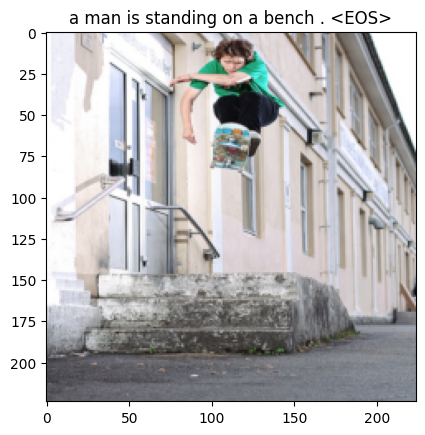

Epoch: 3 loss: 2.91793


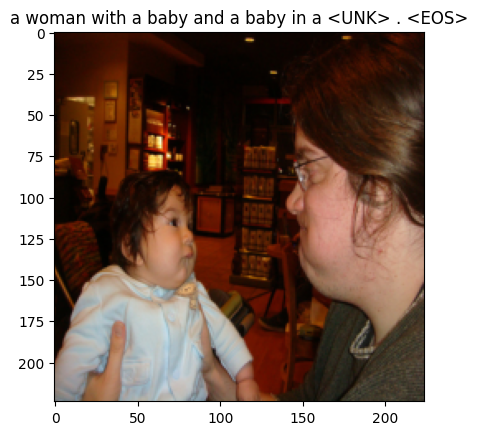

Epoch: 3 loss: 2.10459


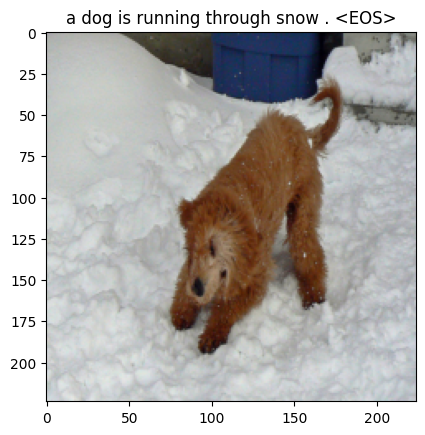

Epoch: 4 loss: 2.76897


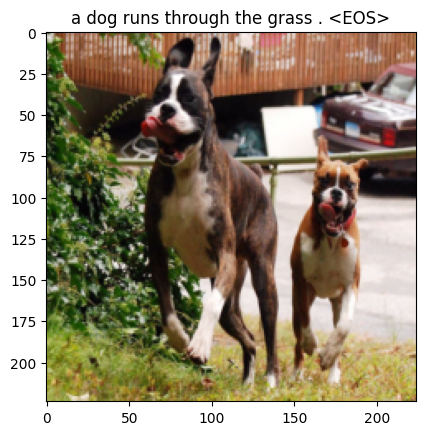

Epoch: 4 loss: 2.73383


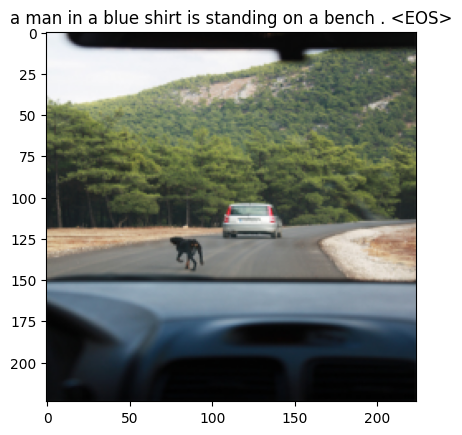

Epoch: 5 loss: 2.22793


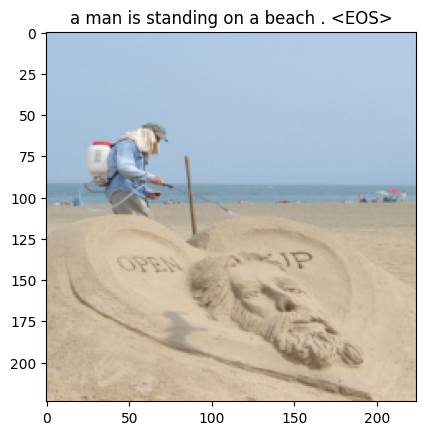

Epoch: 5 loss: 2.27500


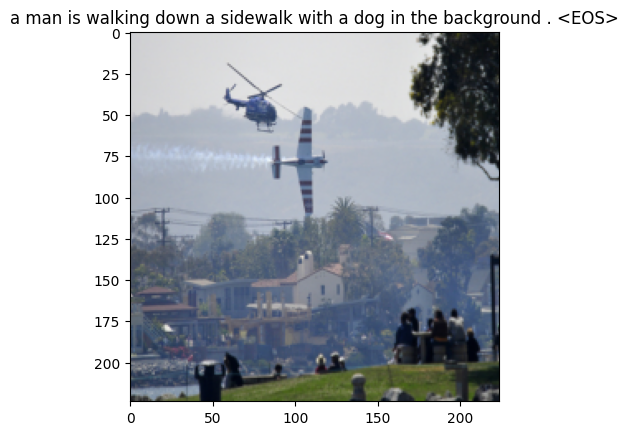

Epoch: 6 loss: 2.35501


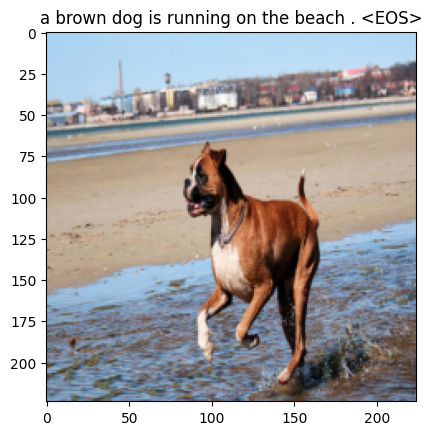

Epoch: 6 loss: 1.97956


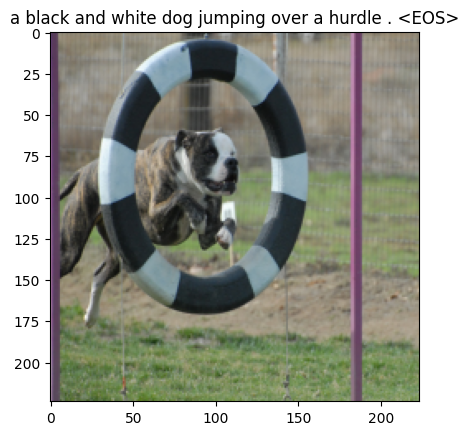

Epoch: 7 loss: 2.51494


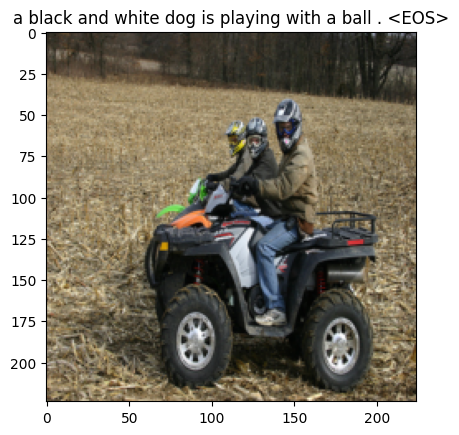

Epoch: 7 loss: 2.28870


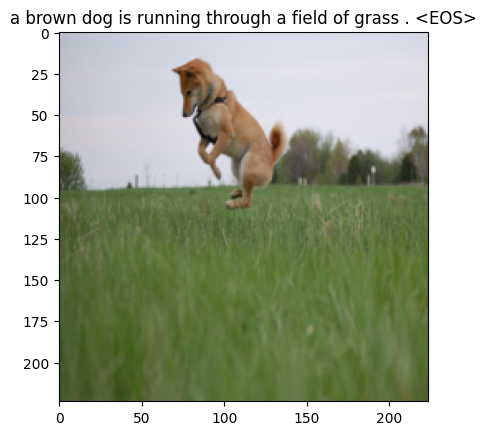

Epoch: 8 loss: 1.65418


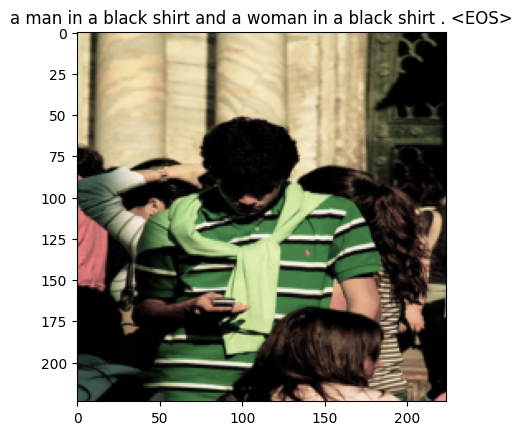

Epoch: 8 loss: 2.51192


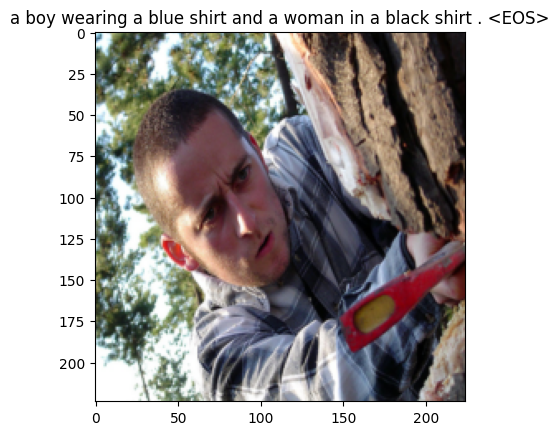

Epoch: 9 loss: 2.56626


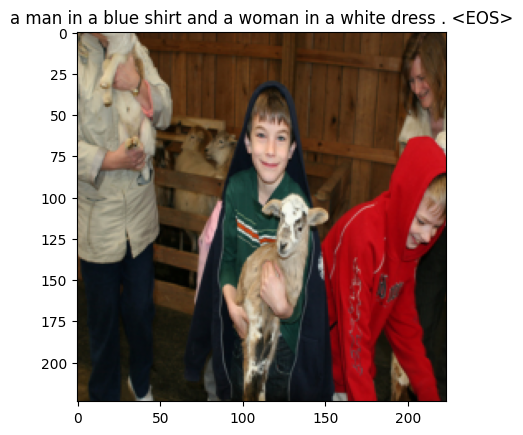

Epoch: 9 loss: 2.28500


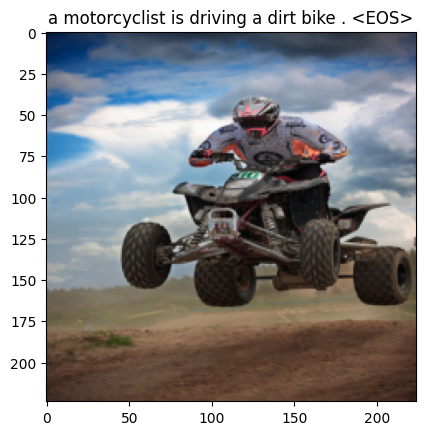

Epoch: 10 loss: 2.46496


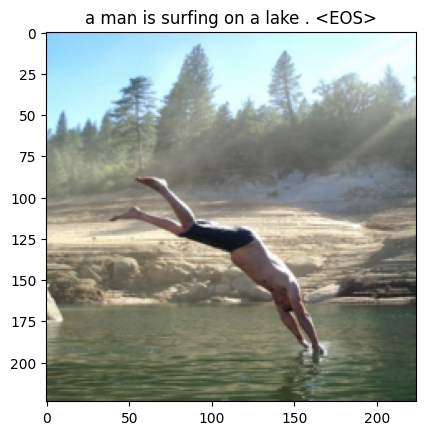

Epoch: 10 loss: 2.18294


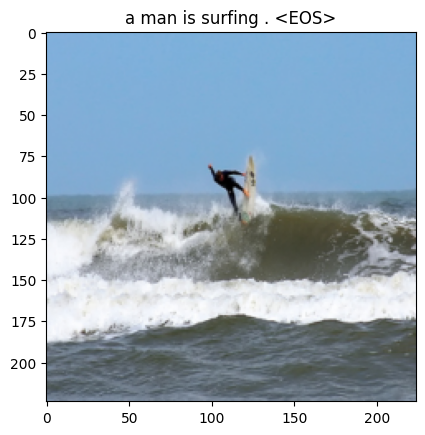

Epoch: 11 loss: 2.17977


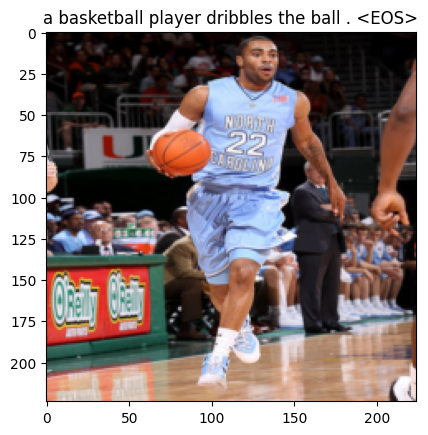

Epoch: 11 loss: 2.14217


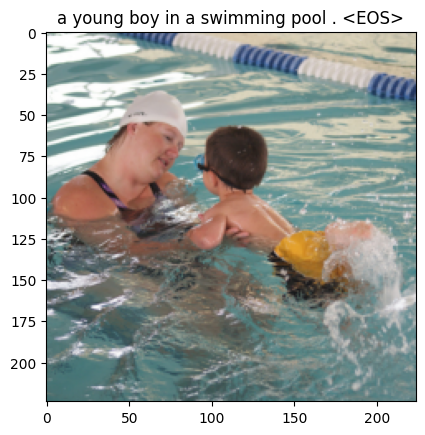

Epoch: 12 loss: 2.39323


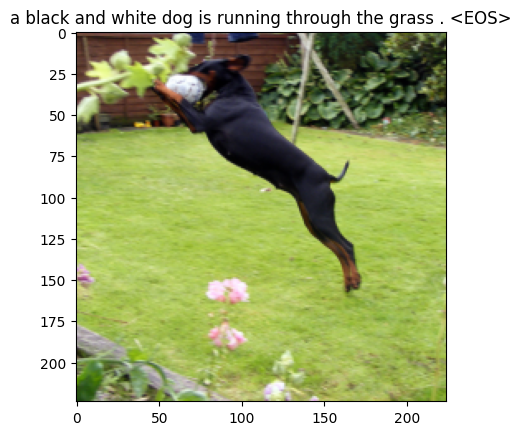

Epoch: 12 loss: 2.93879


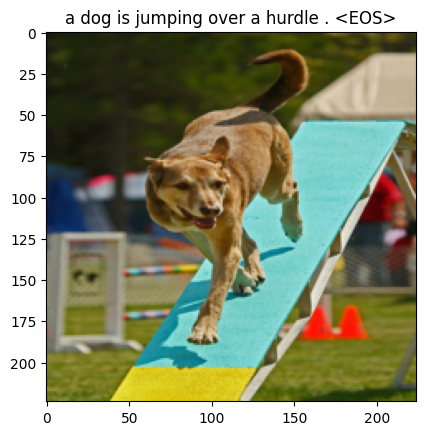

Epoch: 13 loss: 2.23253


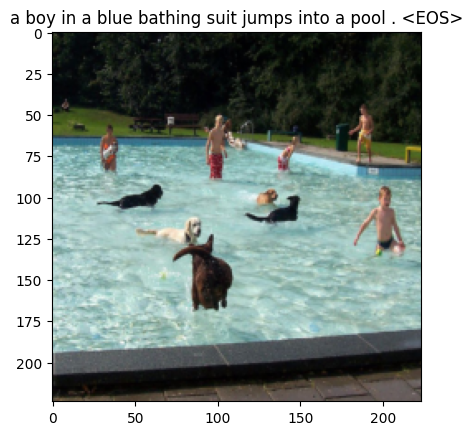

Epoch: 13 loss: 2.41835


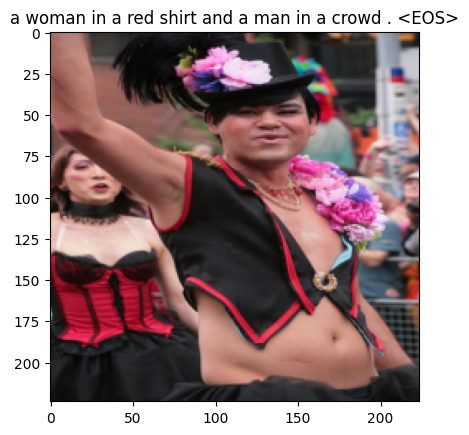

Epoch: 14 loss: 2.26410


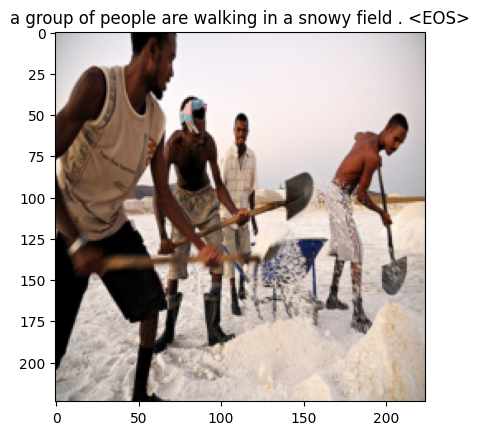

Epoch: 14 loss: 2.18993


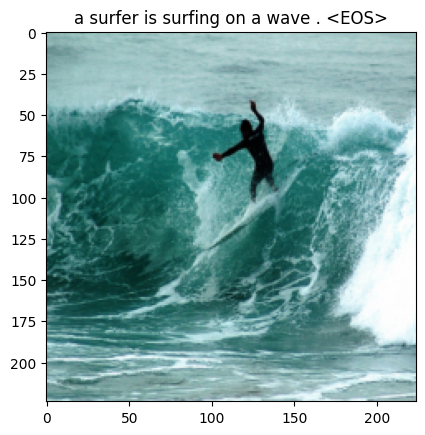

Epoch: 15 loss: 1.80335


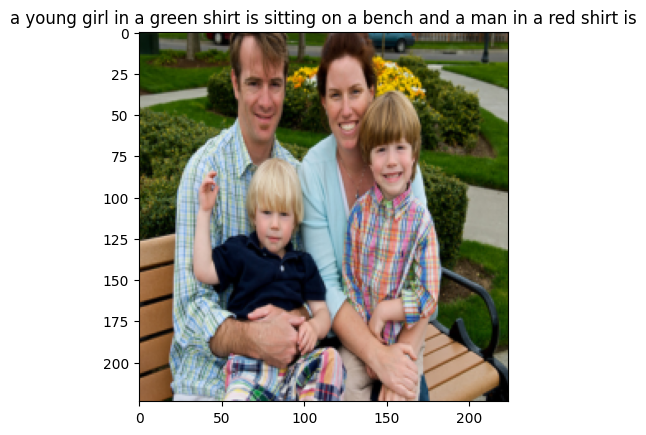

Epoch: 15 loss: 2.43701


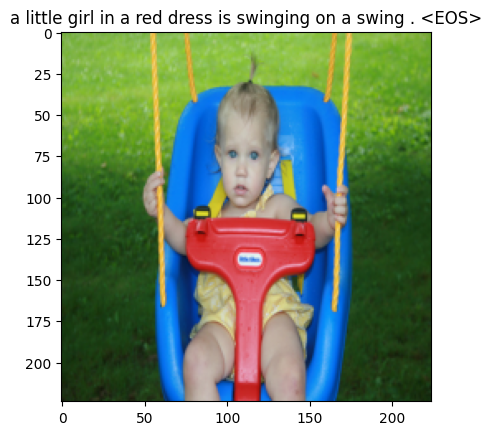

Epoch: 16 loss: 2.26538


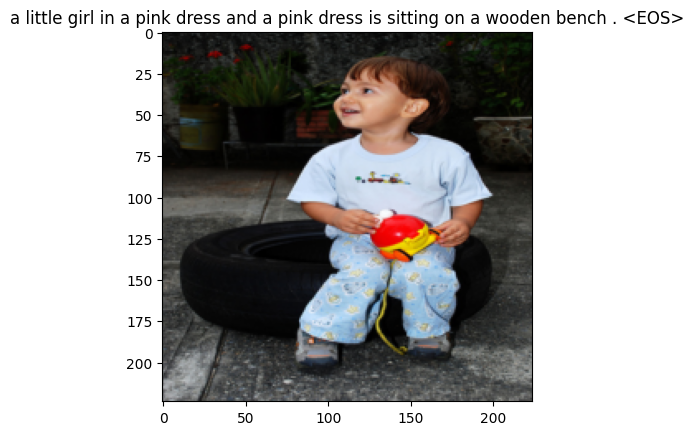

Epoch: 16 loss: 1.83398


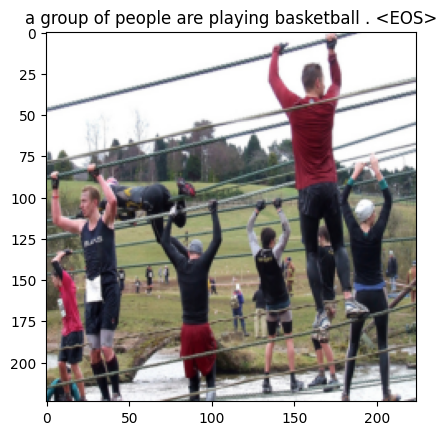

Epoch: 17 loss: 2.08509


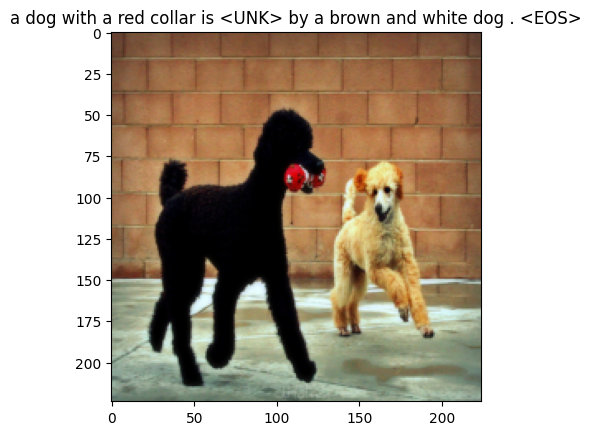

Epoch: 17 loss: 2.50206


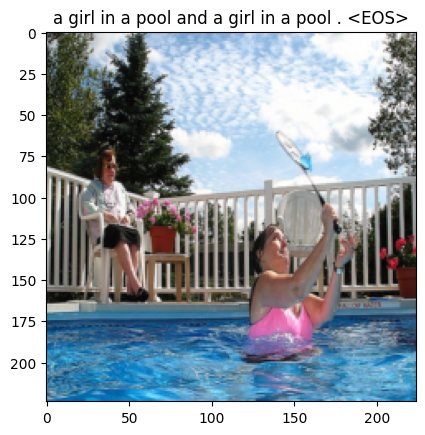

Epoch: 18 loss: 2.39353


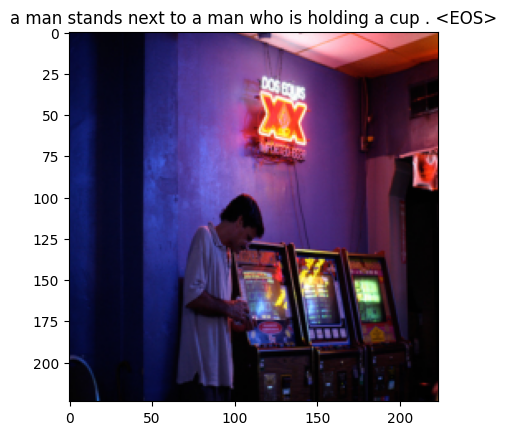

Epoch: 18 loss: 2.39658


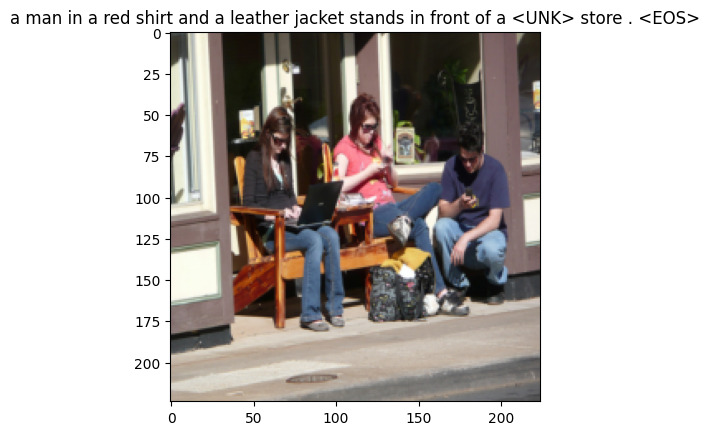

Epoch: 19 loss: 1.87858


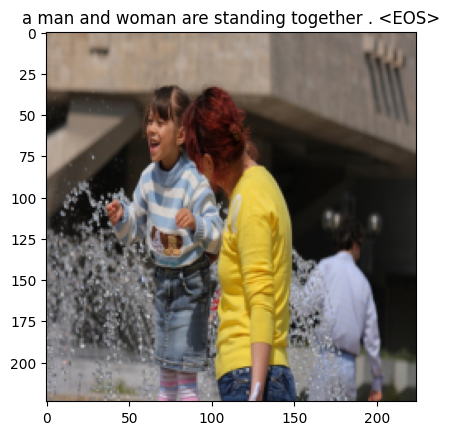

Epoch: 19 loss: 2.84459


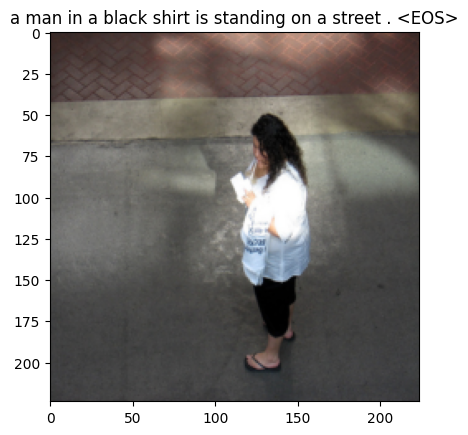

Epoch: 20 loss: 1.75227


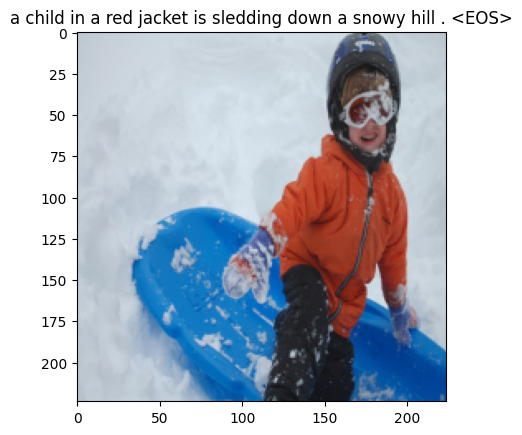

Epoch: 20 loss: 2.62590


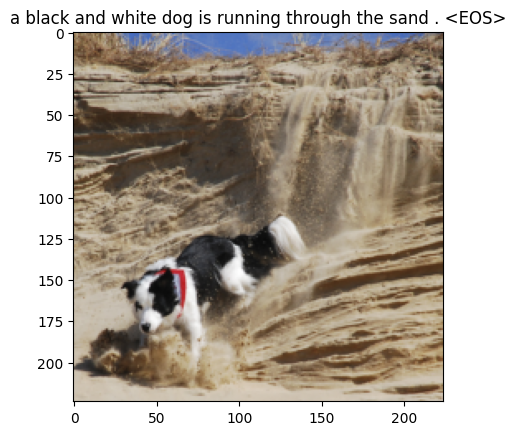

In [49]:
num_epochs = 20
print_every = 4000

for epoch in range(1,num_epochs+1):   
    for idx, (image, captions) in enumerate(iter(data_loader)):
        image,captions = image.to(device),captions.to(device)

        # Zero the gradients.
        optimizer.zero_grad()

        # Feed forward
        outputs,attentions = model(image, captions)

        # Calculate the batch loss.
        targets = captions[:,1:]
        loss = criterion(outputs.view(-1, vocab_size), targets.reshape(-1))
        
        # Backward pass.
        loss.backward()

        # Update the parameters in the optimizer.
        optimizer.step()

        writer.add_scalar("Trainingloss/epoch", loss.item(), epoch)
        if (idx+1)%print_every == 0:
            print("Epoch: {} loss: {:.5f}".format(epoch,loss.item()))
            
            
            #generate the caption
            model.eval()
            with torch.no_grad():
                dataiter = iter(data_loader)
                img,_ = next(dataiter)
                features = model.encoder(img[0:1].to(device))
                caps,alphas = model.decoder.generate_caption(features,vocab=dataset.vocab)
                caption = ' '.join(caps)
                show_image(img[0],title=caption)
                
            model.train()

Using the Tensorboard for Scalars and setting the horizontal axis as steps doesn't provides a good understanding of the model. However, by changing the horizonrtal axis to relative and/or to wall assists in better understanding of the model.

### The scalar axis graph shows the loss trend based on epoch.

And by setting the horizontal axis as **step** we see the loses for all the 20 epochs as well. 

Thus, going relative and/or wall shows much better.

Another way to get the same thing but for step is to create a new variable steps that keeps on increasing by +1 at each cycle and simply, setting the `global_step = steps` before starting the training loop as follows:



```
writer.add_scalar("Training loss/epoch", loss.item(), global_step = steps)
steps+=1
```

steps is initialised before the outer epoch loop

In [50]:
%load_ext tensorboard
%tensorboard --logdir /content/resnet_lstm --port 8088

<IPython.core.display.Javascript object>

# Testing the model

In this step we take a random image from the testing sample( size : 455), find its generated caption and then find the bleu-scores by comparing the original/human captions to the generated/predicted caption. **bold text**

In [57]:
import random
import pandas as pd
def testing():
  img_no = random.randrange(0,455,5)
  test_data_df = pd.read_csv(test_data_location)
  img_name = test_data_df['image'][img_no]
  original = test_data_df[test_data_df['image'] == img_name]['caption'].tolist()
  ref = []
  for i in original:
    ref.append([token.text.lower() for token in spacy_eng.tokenizer(i)])
  
  print('image_name : \t', img_name)
  print('original_captions: \t', original)
  print('references to be passed: \t', ref)
  model.eval()
  with torch.no_grad():
    img_location = os.path.join(image_data_location,img_name)
    img = Image.open(img_location).convert("RGB")
    transformed_image = transforms(img)
    show_image(transformed_image)
    features = model.encoder(transformed_image.unsqueeze(0).to(device))
    caps,_ = model.decoder.generate_caption(features, vocab = dataset.vocab)
    _1,_2,_3,_4 = bleu_score(ref, caps)
    return _1, _2, _3, _4



# Finding the bleu scores

In [58]:
from nltk.translate.bleu_score import SmoothingFunction
smoothie = SmoothingFunction().method4
def bleu_score(original_captions, generated_caption):
  #generated_caption.remove('<SOS>')
  #generated_caption.remove('<EOS>')
  print('BLEU Scores :')
  print('A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.')
  b_1 = sentence_bleu(original_captions, generated_caption, weights=(1.0, 0, 0, 0))
  b_2 = sentence_bleu(original_captions, generated_caption, weights=(0.5, 0.5, 0, 0))
  b_3 = sentence_bleu(original_captions, generated_caption, weights=(0.3, 0.3, 0.3, 0), smoothing_function  = smoothie)
  b_4 = sentence_bleu(original_captions, generated_caption, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function = smoothie)

  print("\ngenerated-caption : \t" , ' '.join(generated_caption))

  print('BLEU-1: %f' % b_1)
  print('BLEU-2: %f' % b_2)
  print('BLEU-3: %f' % b_3)
  print('BLEU-4: %f' % b_4)

  return b_1, b_2, b_3, b_4

# FInding the average bleu-scores of 10 random samples(images) from the testing data.


*****NEW_INPUT*******



image_name : 	 888517718_3d5b4b7b43.jpg
original_captions: 	 ['A brown and black dog is standing on its hind legs trying to catch something .', 'A dog is jumping up on hind legs with its mouth open .', 'A dog plays on the grass .', 'A German shepherd playing with water in the grass .', 'German Shepherd standing up snapping at droplets of water']
references to be passed: 	 [['a', 'brown', 'and', 'black', 'dog', 'is', 'standing', 'on', 'its', 'hind', 'legs', 'trying', 'to', 'catch', 'something', '.'], ['a', 'dog', 'is', 'jumping', 'up', 'on', 'hind', 'legs', 'with', 'its', 'mouth', 'open', '.'], ['a', 'dog', 'plays', 'on', 'the', 'grass', '.'], ['a', 'german', 'shepherd', 'playing', 'with', 'water', 'in', 'the', 'grass', '.'], ['german', 'shepherd', 'standing', 'up', 'snapping', 'at', 'droplets', 'of', 'water']]


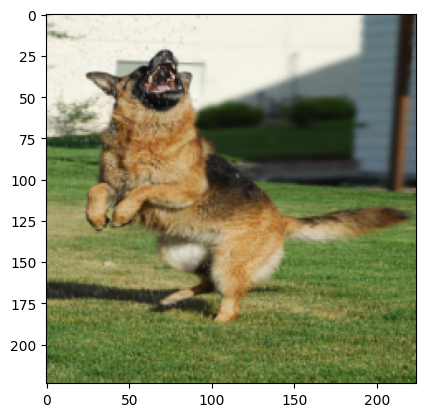

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 a dog is running on the grass . <EOS>
BLEU-1: 0.777778
BLEU-2: 0.697217
BLEU-3: 0.624637
BLEU-4: 0.431670

*****NEW_INPUT*******



image_name : 	 952171414_2db16f846f.jpg
original_captions: 	 ['a group of four people conversing next to a bus', 'Four people taking in front of a bus .', 'Four teenagers standing next to a bus and talking and laughing .', 'the two couples are chatting by the bus .', 'Two girls and two guys are talking to each other with a bus in the background .']
references to be passed: 	 [['a', 'group', 'of', 'four', 'people', 'conversing', 'next', 'to', 'a', 'bus'], ['four', 'people', 'taking', 'in', 'front', 'of', 'a', 'bus', '.'], ['four', 'teenagers', 'standing', 'next', 'to', 'a', 'bus', 'and', 'talking', 'and', 'laughing', '.'], ['the', 'two', 'couples', 'are', 'chatting', 'by', 'the', 'bus', '.'], ['two', 'girls', 'and', 'two', 'g

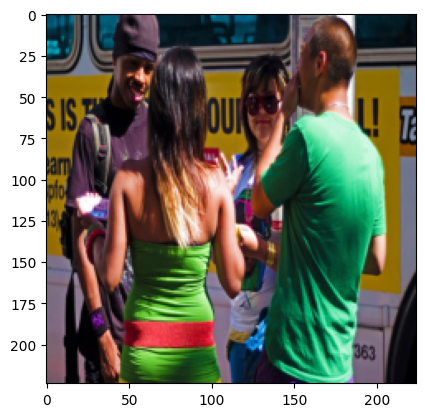

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 a woman in a red dress is sitting on a bus stop . <EOS>
BLEU-1: 0.357143
BLEU-2: 0.165748
BLEU-3: 0.108231
BLEU-4: 0.051886

*****NEW_INPUT*******



image_name : 	 929679367_ff8c7df2ee.jpg
original_captions: 	 ['A beagle is playing with a tennis ball .', 'A puppy dog is playing with a tennis ball .', 'A puppy is playing with a tennis ball on a well-kept path lined with groomed bushes .', 'A puppy plays with a tennis ball on a stone path .', 'A white-footed beagle plays with a tennis ball on a garden path .']
references to be passed: 	 [['a', 'beagle', 'is', 'playing', 'with', 'a', 'tennis', 'ball', '.'], ['a', 'puppy', 'dog', 'is', 'playing', 'with', 'a', 'tennis', 'ball', '.'], ['a', 'puppy', 'is', 'playing', 'with', 'a', 'tennis', 'ball', 'on', 'a', 'well', '-', 'kept', 'path', 'lined', 'with', 'groomed', 'bushes', '.'], ['a', 'puppy', 'plays', 'with'

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


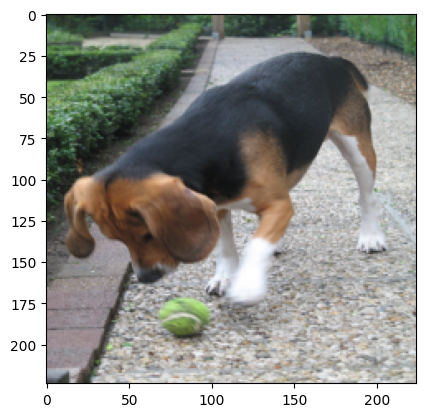

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 a dog is drinking water from a sprinkler . <EOS>
BLEU-1: 0.500000
BLEU-2: 0.235702
BLEU-3: 0.144929
BLEU-4: 0.071612

*****NEW_INPUT*******



image_name : 	 899810584_61e1578d3f.jpg
original_captions: 	 ['A man climbing a mountain .', 'A man is climbing up a very large rock .', 'A person hanging from a rocky cliff .', 'A person in red rock climbing , a mountain in the background .', 'A person wearing red clings to a rock face .']
references to be passed: 	 [['a', 'man', 'climbing', 'a', 'mountain', '.'], ['a', 'man', 'is', 'climbing', 'up', 'a', 'very', 'large', 'rock', '.'], ['a', 'person', 'hanging', 'from', 'a', 'rocky', 'cliff', '.'], ['a', 'person', 'in', 'red', 'rock', 'climbing', ',', 'a', 'mountain', 'in', 'the', 'background', '.'], ['a', 'person', 'wearing', 'red', 'clings', 'to', 'a', 'rock', 'face', '.']]


/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


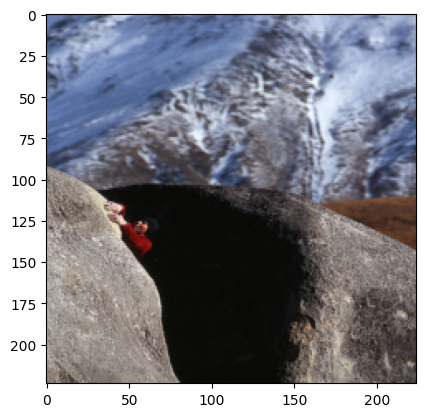

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 a man in a red jacket is climbing up a mountain . <EOS>
BLEU-1: 0.769231
BLEU-2: 0.620174
BLEU-3: 0.508425
BLEU-4: 0.320029

*****NEW_INPUT*******



image_name : 	 95734038_2ab5783da7.jpg
original_captions: 	 ['A man on a bike nest to a river .', 'A man rides a bicycle on a rocky path beside a lake in the mountains .', 'A man rides a bicycle on a rocky trail along a large river .', 'A man stands astride a bike on a rocky trail by a lake .', 'The man on the bike is sitting on a gravel hill .']
references to be passed: 	 [['a', 'man', 'on', 'a', 'bike', 'nest', 'to', 'a', 'river', '.'], ['a', 'man', 'rides', 'a', 'bicycle', 'on', 'a', 'rocky', 'path', 'beside', 'a', 'lake', 'in', 'the', 'mountains', '.'], ['a', 'man', 'rides', 'a', 'bicycle', 'on', 'a', 'rocky', 'trail', 'along', 'a', 'large', 'river', '.'], ['a', 'man', 'stands', 'astride', 'a', 'bike', 

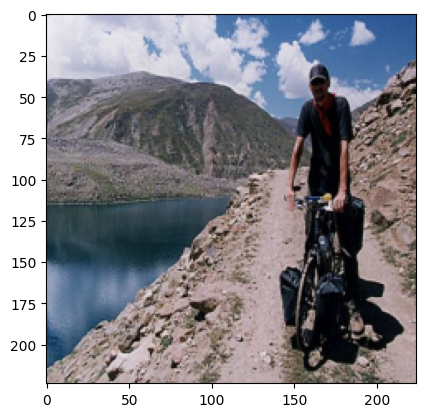

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 a man in a red jacket and a backpack is walking through a snowy mountain . <EOS>
BLEU-1: 0.470588
BLEU-2: 0.171499
BLEU-3: 0.105539
BLEU-4: 0.048692

*****NEW_INPUT*******



image_name : 	 925491651_57df3a5b36.jpg
original_captions: 	 ['A dog leaps out of the water .', 'a small dog jumping threw some a lake', 'A tan dog jumps into water .', 'A white dog is splashing through the water .', 'Dog jumping out of water in a lake .']
references to be passed: 	 [['a', 'dog', 'leaps', 'out', 'of', 'the', 'water', '.'], ['a', 'small', 'dog', 'jumping', 'threw', 'some', 'a', 'lake'], ['a', 'tan', 'dog', 'jumps', 'into', 'water', '.'], ['a', 'white', 'dog', 'is', 'splashing', 'through', 'the', 'water', '.'], ['dog', 'jumping', 'out', 'of', 'water', 'in', 'a', 'lake', '.']]


/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


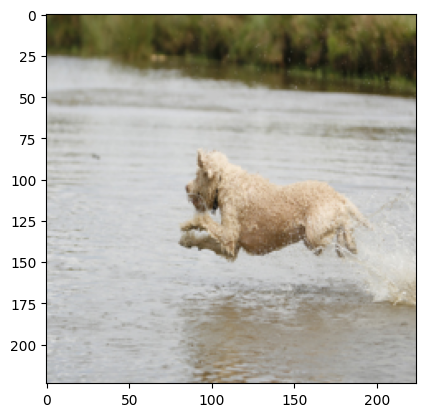

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 a dog is running through water . <EOS>
BLEU-1: 0.750000
BLEU-2: 0.566947
BLEU-3: 0.259456
BLEU-4: 0.123369

*****NEW_INPUT*******



image_name : 	 953941506_5082c9160c.jpg
original_captions: 	 ['A Beagle dog is walking on the shoreline at the beach .', 'A beagle walking on the beach next to some waves .', 'A beagle walks along the calm shore .', 'The beagle is on a beach walking along the shoreline', 'The beagle is walking on the beach at the waterline .']
references to be passed: 	 [['a', 'beagle', 'dog', 'is', 'walking', 'on', 'the', 'shoreline', 'at', 'the', 'beach', '.'], ['a', 'beagle', 'walking', 'on', 'the', 'beach', 'next', 'to', 'some', 'waves', '.'], ['a', 'beagle', 'walks', 'along', 'the', 'calm', 'shore', '.'], ['the', 'beagle', 'is', 'on', 'a', 'beach', 'walking', 'along', 'the', 'shoreline'], ['the', 'beagle', 'is', 'walking', 'on', 'the',

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


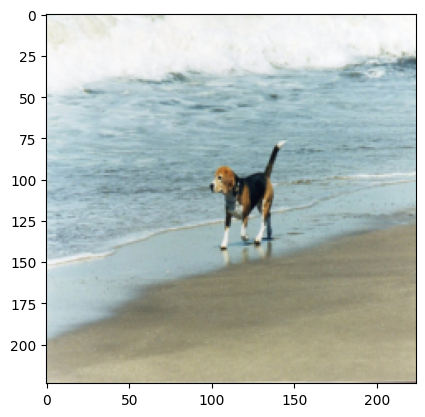

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 a dog is running through the ocean . <EOS>
BLEU-1: 0.555556
BLEU-2: 0.263523
BLEU-3: 0.159047
BLEU-4: 0.079483

*****NEW_INPUT*******



image_name : 	 934375844_dd149fed18.jpg
original_captions: 	 ['A baby in a white top is sitting on a bed .', 'A baby wearing a " my best buddy " shirt on a bed .', 'A cute baby boy is sitting on the bed looking very happy .', 'A small baby sits on a bed and smiles .', 'Small boy wearing blue shorts sitting on bed .']
references to be passed: 	 [['a', 'baby', 'in', 'a', 'white', 'top', 'is', 'sitting', 'on', 'a', 'bed', '.'], ['a', 'baby', 'wearing', 'a', '"', 'my', 'best', 'buddy', '"', 'shirt', 'on', 'a', 'bed', '.'], ['a', 'cute', 'baby', 'boy', 'is', 'sitting', 'on', 'the', 'bed', 'looking', 'very', 'happy', '.'], ['a', 'small', 'baby', 'sits', 'on', 'a', 'bed', 'and', 'smiles', '.'], ['small', 'boy', 'wearing', 'blu

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


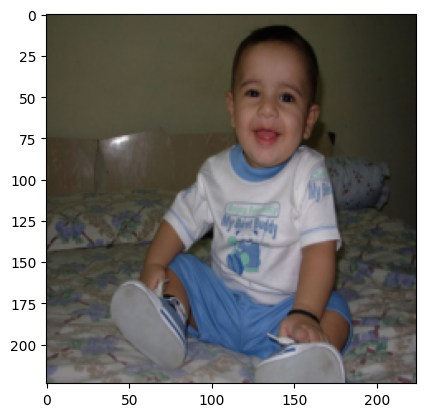

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 a baby in a blue shirt is sitting on a wooden floor . <EOS>
BLEU-1: 0.785714
BLEU-2: 0.602194
BLEU-3: 0.530524
BLEU-4: 0.385032

*****NEW_INPUT*******



image_name : 	 909191414_1cf5d85821.jpg
original_captions: 	 ['A boy is leaping over a blue hose pipe as a little girl watches .', 'A boy is leaping while his sister plays around a hose .', 'A young boy jumping in front of a young girl and a house .', 'Children are playing in and around a garden tube in the front yard of a house .', 'Two children playing above a blue water hose .']
references to be passed: 	 [['a', 'boy', 'is', 'leaping', 'over', 'a', 'blue', 'hose', 'pipe', 'as', 'a', 'little', 'girl', 'watches', '.'], ['a', 'boy', 'is', 'leaping', 'while', 'his', 'sister', 'plays', 'around', 'a', 'hose', '.'], ['a', 'young', 'boy', 'jumping', 'in', 'front', 'of', 'a', 'young', 'girl', 'and', 'a', 'hou

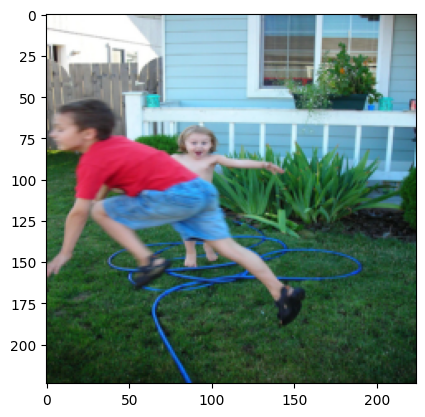

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 a boy in a blue shirt is jumping over a pole . <EOS>
BLEU-1: 0.769231
BLEU-2: 0.438529
BLEU-3: 0.197472
BLEU-4: 0.087083

*****NEW_INPUT*******



image_name : 	 961611340_251081fcb8.jpg
original_captions: 	 ['A girl in a tutu and a boy in a costume in a dancefloor .', 'A little girl in a pink tutu gets ready for ballet dancing , a boy in a Spider-Man shirt behind .', 'a young girl wearing a pink tutu dancing with another young boy in the background .', 'A young girl wearing a tutu dances in a large room .', 'Two children are in costume in a dance studio .']
references to be passed: 	 [['a', 'girl', 'in', 'a', 'tutu', 'and', 'a', 'boy', 'in', 'a', 'costume', 'in', 'a', 'dancefloor', '.'], ['a', 'little', 'girl', 'in', 'a', 'pink', 'tutu', 'gets', 'ready', 'for', 'ballet', 'dancing', ',', 'a', 'boy', 'in', 'a', 'spider', '-', 'man', 'shirt', 'behind', '.'

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


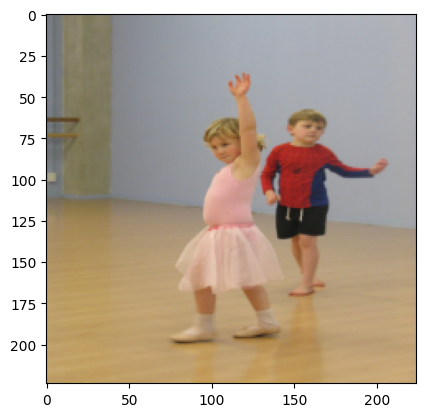

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 a young boy in a blue shirt is playing basketball . <EOS>
BLEU-1: 0.583333
BLEU-2: 0.460566
BLEU-3: 0.387511
BLEU-4: 0.184999

****FINDING AVERAGE SCORES****

Average_BLEU-1_score_for_the_above_printed_images: 0.631857
Average_BLEU-2_score_for_the_above_printed_images: 0.422210
Average_BLEU-3_score_for_the_above_printed_images: 0.302577
Average_BLEU-4_score_for_the_above_printed_images: 0.178386


/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


In [61]:
b_1 = []
b_2 = []
b_3 = []
b_4 = []
for i in range(10):
  print('\n*****NEW_INPUT*******\n')
  print('\n')
  _1, _2, _3, _4 = testing()
  b_1.append(_1)
  b_2.append(_2)
  b_3.append(_3)
  b_4.append(_4)

print('\n****FINDING AVERAGE SCORES****\n')
from statistics import mean
print('Average_BLEU-1_score_for_the_above_printed_images: %f' % mean(b_1))
print('Average_BLEU-2_score_for_the_above_printed_images: %f' % mean(b_2))
print('Average_BLEU-3_score_for_the_above_printed_images: %f' % mean(b_3))
print('Average_BLEU-4_score_for_the_above_printed_images: %f' % mean(b_4))

**FROM THE ABOVE WE CAN CLEARLY UNDERSTAND ON THING :**

***THE MODEL IS PRIORITISING SINGLE WORDS OVER A COMPLETED AND BETTER SENTENCE***

THIS IS DUE TO **`argmax`** function used while generating captions.


*As can be seen from above the average values of bleu_scores. These values indicate that 1-gram bleu-score is better while 4-gram bleu score is not good. This attributes to the above stated fact that the model is preferring individual words over the complete sentences. This could potentially be solved somewhat by using beam-search based prediction method and utilizing attention layers.*

However, the key point to notice here is that the average is calculated by randomly choosing only 10 images. These Average scores can potentially increase/dexrease by taking a bigger sample or just by rerunning the testing the above loop.

However, an easier way to do is to increase the number of training epochs. One can try to train their own individual model by taking these as a starting point to further train models for more epochs and/or try beam-search based prediction techniques.  